# Feature extraction: naive methods

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import os
import sys
from copy import deepcopy

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import pandas as pd
pd.options.display.max_columns = 100
import umap
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


if __package__ is None:

    module_path = os.path.abspath(os.path.join('..'))
    sys.path.append(module_path)

    __package__ = os.path.basename(module_path)


from src.utils.results.visualisation import hist3d
from explanations.data_enhancing import enhance_data


2023-05-12 09:49:04.047473: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-12 09:49:04.226340: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-05-12 09:49:04.959180: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: :/home/wadh6511/miniconda3/lib/
2023-05-12 09:49:04.959551: W tensorflow/compiler/xla/s

## Process data

In [3]:
# fn = '../data/ensemble_mutation_effect_analysis/2023_04_11_192013/summarise_simulation/tabulated_mutation_info.csv'
fn = '../data/ensemble_mutation_effect_analysis/2023_05_09_220322/summarise_simulation/tabulated_mutation_info.csv'
info = pd.read_csv(fn)

In [ ]:
info, infom, info_summ = enhance_data(info) 

## Features

Convert to Z-scores

In [ ]:
data = info[(info['sample_name'] == 'RNA_1')].dropna(axis=1)
# numerical_cols = 
# data = data[np.abs(data[numerical_cols]) < 1e11]
d = data[['sensitivity_wrt_species-6', 'precision_wrt_species-6']]
scaled_data_sp = StandardScaler().fit_transform(d)

Grouped

In [6]:
infom[(infom['idx'] != 'energies_1-0') & (infom['idx'] != 'energies_2-0') & (infom['idx'] != 'energies_2-1')].pivot_table('binding_rates_dissociation', ['idx'], ['circuit_name', 'mutation_name'])


circuit_name  toy_circuit_combo0_100365                                      \
mutation_name                RNA_0_m1-0  RNA_0_m1-1  RNA_0_m1-2  RNA_0_m1-3   
idx                                                                           
energies_0-0                 899.999500  899.999500  899.999500  899.999500   
energies_0-1                   8.218554   30.520367   26.216637    2.813401   
energies_0-2                 108.896095   16.616467  899.999500    0.847380   
energies_1-1                   2.495263    2.495263    2.495263    2.495263   
energies_1-2                 899.999500  899.999500  899.999500  899.999500   
energies_2-2                   0.727890    0.727890    0.727890    0.727890   

circuit_name                                                               \
mutation_name  RNA_0_m1-4  RNA_0_m1-5  RNA_0_m1-6  RNA_0_m1-7  RNA_0_m1-8   
idx                                                                         
energies_0-0   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_0-1    83.629320    4.770228  899.999500   26.216637   34.688015   
energies_0-2   899.999500    1.459938   20.788380  899.999500  899.999500   
energies_1-1     2.495263    2.495263    2.495263    2.495263    2.495263   
energies_1-2   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_2-2     0.727890    0.727890    0.727890    0.727890    0.727890   

circuit_name                                                               \
mutation_name  RNA_0_m1-9 RNA_0_m10-0 RNA_0_m10-1 RNA_0_m10-2 RNA_0_m10-3   
idx                                                                         
energies_0-0   899.999500  899.999500  899.999500  899.999500    0.896187   
energies_0-1    79.709930    8.832112  899.999500  300.784550  899.999500   
energies_0-2     2.475381  899.999500  899.999500  899.999500    0.215756   
energies_1-1     2.495263    2.495263    2.495263    2.495263    2.495263   
energies_1-2   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_2-2     0.727890    0.727890    0.727890    0.727890    0.727890   

circuit_name                                                               \
mutation_name RNA_0_m10-4 RNA_0_m10-5 RNA_0_m10-6 RNA_0_m10-7 RNA_0_m10-8   
idx                                                                         
energies_0-0   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_0-1   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_0-2     3.381753    3.197580    3.354807    0.917956    9.192557   
energies_1-1     2.495263    2.495263    2.495263    2.495263    2.495263   
energies_1-2   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_2-2     0.727890    0.727890    0.727890    0.727890    0.727890   

circuit_name                                                               \
mutation_name RNA_0_m10-9 RNA_0_m15-0 RNA_0_m15-1 RNA_0_m15-2 RNA_0_m15-3   
idx                                                                         
energies_0-0   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_0-1   899.999500   16.222420  899.999500  899.999500  899.999500   
energies_0-2     0.661262  899.999500    2.975447  467.030330  899.999500   
energies_1-1     2.495263    2.495263    2.495263    2.495263    2.495263   
energies_1-2   899.999500  899.999500  899.999500  899.999500  899.999500   
energies_2-2     0.727890    0.727890    0.727890    0.727890    0.727890   

circuit_name                                                               \
mutation_name RNA_0_m15-4 RNA_0_m15-5 RNA_0_m15-6 RNA_0_m15-7 RNA_0_m15-8   
idx                                                                         
energies_0-0   899.999500  899.999500  899.999500  899.999500    0.283199   
energies_0-1   561.377870  899.999500  899.999500  899.999500  899.999500   
energies_0-2   899.999500    2.378319  899.999500   24.591337    1.244077   
energies_1-1     2.495263    2.495263    2.495263 

In [7]:
# grp_mutations = infom.pivot_table('binding_rates_dissociation', ['sample_name', 'mutation_name', 'idx'], 'circuit_name').T.to_numpy()
grp_mutations = infom[(infom['idx'] != 'energies_1-0') & (infom['idx'] != 'energies_2-0') & (infom['idx'] != 'energies_2-1')].pivot_table('binding_rates_dissociation', ['idx'], ['circuit_name', 'mutation_name']).T.to_numpy()
scaled_data = StandardScaler().fit_transform(grp_mutations)


In [8]:
grp_mutations.shape

(181000, 6)

## UMAP

In [1]:
# fig = px.scatter_3d(
#     mutation_log,
#     x=embedding[:, 0], y=embedding[:, 1], z='sp_distance', 
#     color=[sns.color_palette()[x] for x in info['sample_name'].map({"RNA_0":0, "RNA_1":1, "RNA_2":2})])
# fig.show()

# fig = hist3d(data=None, x=embedding[:, 0], y=embedding[:, 1])
# fig.show()

In [ ]:
# digits_df = pd.DataFrame(digits.data[:,1:11])
# digits_df['digit'] = pd.Series(digits.target).map(lambda x: 'Digit {}'.format(x))
# sns.pairplot(digits_df, hue='digit', palette='Spectral');

## TSNE

### TSNE on precision vs. sensitivity

In [ ]:
# tsne = TSNE(n_components=2, random_state=0)
# projections = tsne.fit_transform(d)

In [ ]:
# data['projection_0'] = projections[:, 0]
# data['projection_1'] = projections[:, 1]

In [2]:

# fig = px.scatter(
#     data, x='projection_0', y='projection_1',
#     color='num_interacting_all', labels={'color': 'num_interacting_all'},
#     hover_name="circuit_name"
# )
# fig.show()

### Multi-value per circuit

In [11]:
projections_g = np.array([])
for seed in [0]:
    tsne = TSNE(n_components=2, random_state=seed)
    p = tsne.fit_transform(grp_mutations)
    if len(projections_g):
        projections_g = np.concatenate([projections_g, p])
    else:
        projections_g = p

Visualise

In [12]:
def visualise_embedding(embedding_matrix, i=0, j=1, algorithm='T-SNE'):
    for h in ['mutation_num', 'frac_muts_in_binding_site', 'num_interacting_all', 'num_interacting', 'num_self_interacting', 'sensitivity_wrt_species-6', 'precision_wrt_species-6', 'RMSE', 'fold_change', 'overshoot', 'energies', 'binding_rates_dissociation', 'eqconstants']:
        hue = [
            infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'mean'}).to_numpy().squeeze(),
            infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'std'}).to_numpy().squeeze(),
            infom.groupby(['circuit_name', 'mutation_name']).agg({h: lambda x: np.std(x) / np.where(np.mean(x) != 0, np.mean(x), 1)}).to_numpy().squeeze()
        ]
        # if h in ['sensitivity_wrt_species-6', 'precision_wrt_species-6']:
        #     hue = [np.log(x) for x in hue]

        plt.figure(figsize=(28, 8))
        ax = plt.subplot(1,3,1)
        sns.scatterplot(
            x=embedding_matrix[:, i],
            y=embedding_matrix[:, j],
            hue=hue[0]
        )
        plt.legend(title=h + '_mean')
        plt.ylabel(f'{algorithm} {j}')
        ax = plt.subplot(1,3,2)
        sns.scatterplot(
            x=embedding_matrix[:, i],
            y=embedding_matrix[:, j],
            hue=hue[1]
        )
        plt.xlabel(f'{algorithm} {i}')
        plt.legend(title=h + '_std')
        ax = plt.subplot(1,3,3)
        sns.scatterplot(
            x=embedding_matrix[:, i],
            y=embedding_matrix[:, j],
            hue=hue[2]
        )
        plt.legend(title=h + '_std_normed_by_mean')
        plt.gca().set_aspect('equal', 'datalim')
        

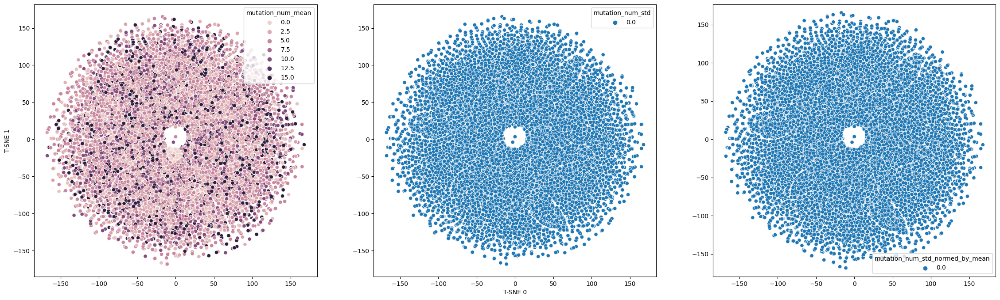

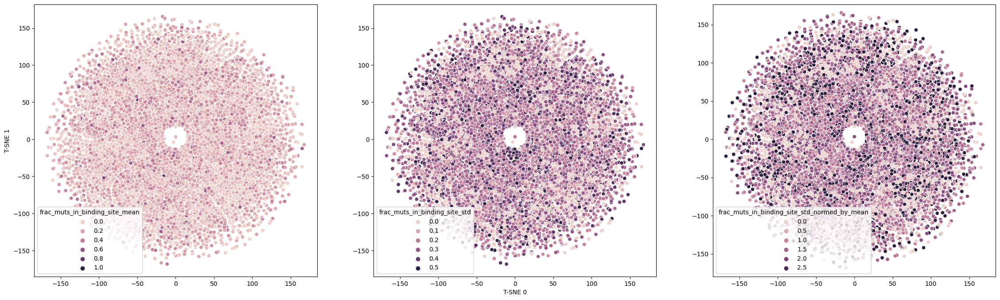

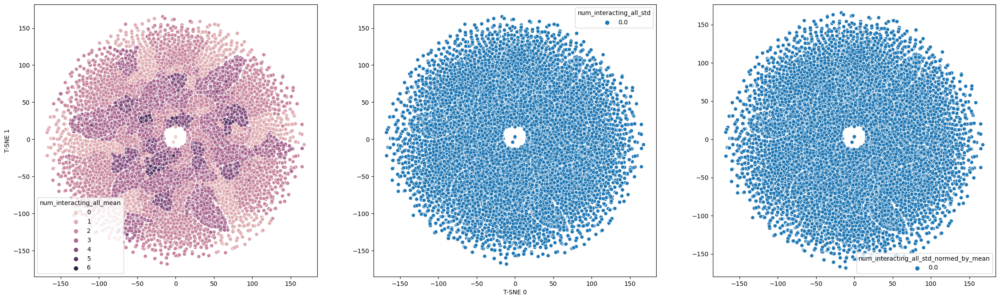

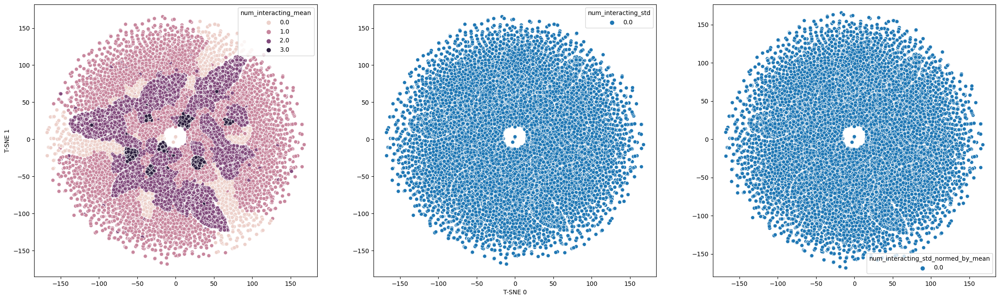

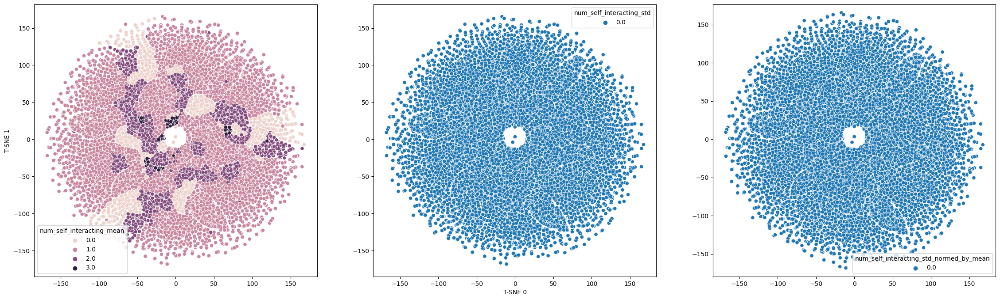

...

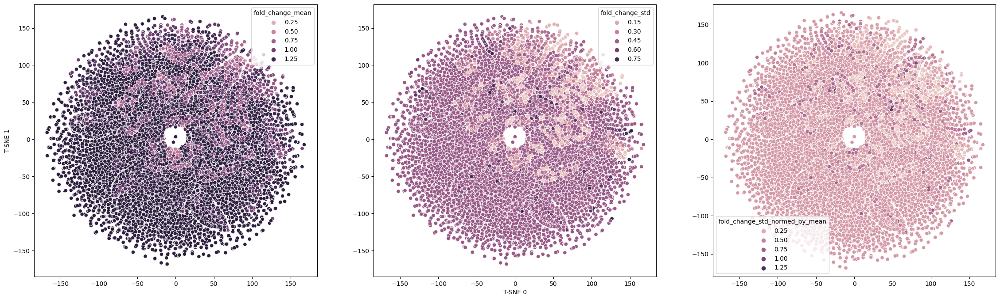

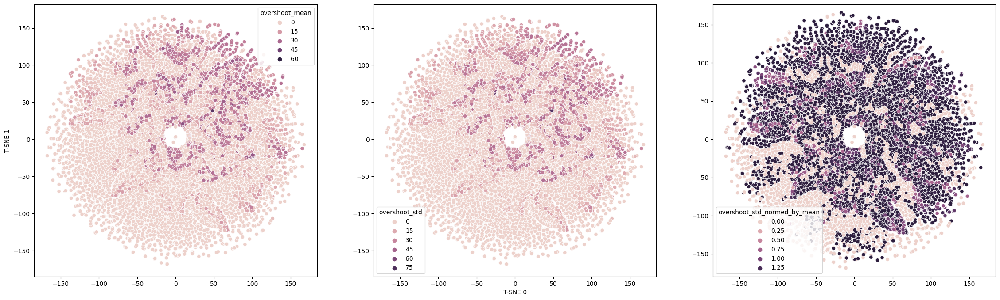

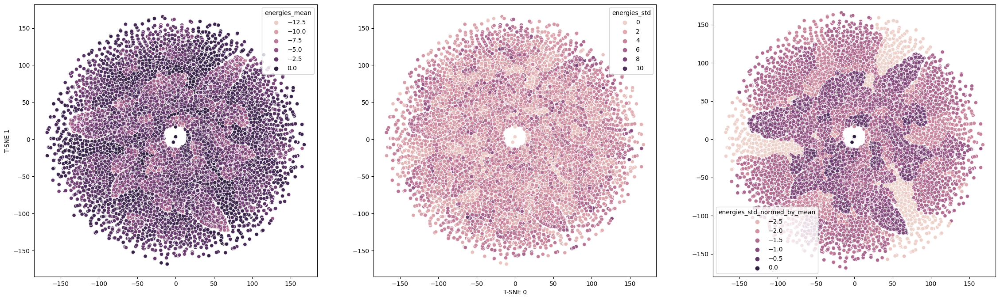

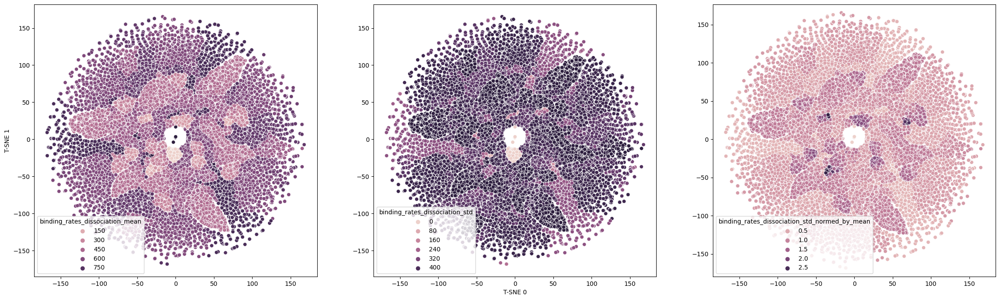

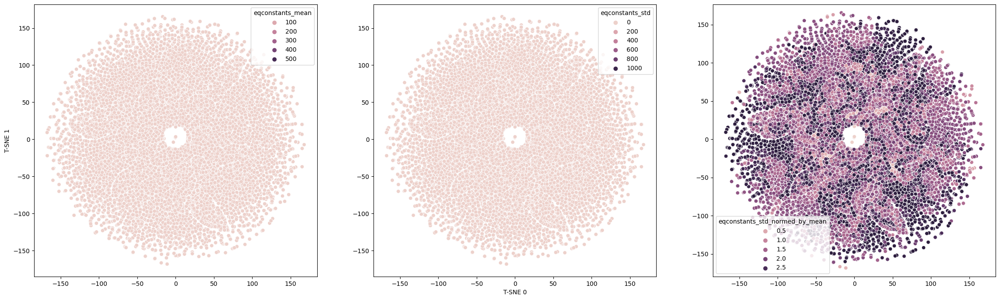

In [15]:
# projections_g_mean = projections_g.reshape((5, grp_mutations.shape[0], 2)).mean(axis=0)
projections_g_mean = projections_g
visualise_embedding(projections_g_mean)

## PCA

In [18]:
pca = PCA(n_components=3)
pca_embedding = pca.fit_transform(grp_mutations)

In [19]:

h = 'num_interacting_all'
fig = px.scatter(
    info[info['sample_name'] == 'RNA_0'], x=pca_embedding[:, 0], y=pca_embedding[:, 2],
    color=infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'mean'}).to_numpy().squeeze(), 
    labels={'color': h},
    hover_name="circuit_name",
    hover_data=['interacting', 'self_interacting']
)
fig.show()

(181000, 3)

In [3]:
# visualise_embedding(pca_embedding, i=0, j = 2, algorithm='PCA')


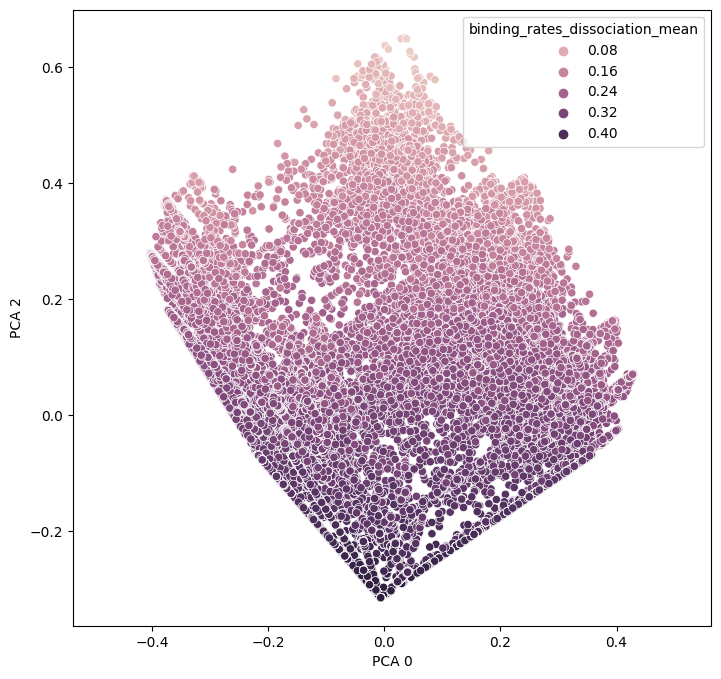

In [ ]:
h = 'binding_rates_dissociation'
# h = 'sensitivity_wrt_species-6'
embedding_matrix = pca_embedding
algorithm = 'PCA'
# for i in np.arange(1, 6):
#     for j in np.arange(i, 6):
i = 0
j = 2
hue = [
    infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'mean'}).to_numpy().squeeze(),
    # infom.groupby(['circuit_name', 'mutation_name']).agg({h: 'std'}).to_numpy().squeeze(),
    # infom.groupby(['circuit_name', 'mutation_name']).agg({h: lambda x: np.std(x) / np.where(np.mean(x) != 0, np.mean(x), 1)}).to_numpy().squeeze()
]
# if h in ['sensitivity_wrt_species-6', 'precision_wrt_species-6']:
#     hue = [np.log(x) for x in hue]

plt.figure(figsize=(28, 8))
ax = plt.subplot(1,3,1)
sns.scatterplot(
    x=embedding_matrix[:, i],
    y=embedding_matrix[:, j],
    hue=hue[0]
)
plt.legend(title=h + '_mean')
plt.ylabel(f'{algorithm} {j}')
# ax = plt.subplot(1,3,2)
# sns.scatterplot(
#     x=embedding_matrix[:, i],
#     y=embedding_matrix[:, j],
#     hue=hue[1]
# )
plt.xlabel(f'{algorithm} {i}')
# plt.legend(title=h + '_std')
# ax = plt.subplot(1,3,3)
# sns.scatterplot(
#     x=embedding_matrix[:, i],
#     y=embedding_matrix[:, j],
#     hue=hue[2]
# )
# plt.legend(title=h + '_std_normed_by_mean')
plt.gca().set_aspect('equal', 'datalim')

In [ ]:
pca.explained_variance_ratio_

array([0.21884375, 0.21785629, 0.1529814 ])

## Quick binding energy examination

<AxesSubplot: xlabel='binding_rates_dissociation_1-1', ylabel='binding_rates_dissociation_0-1'>

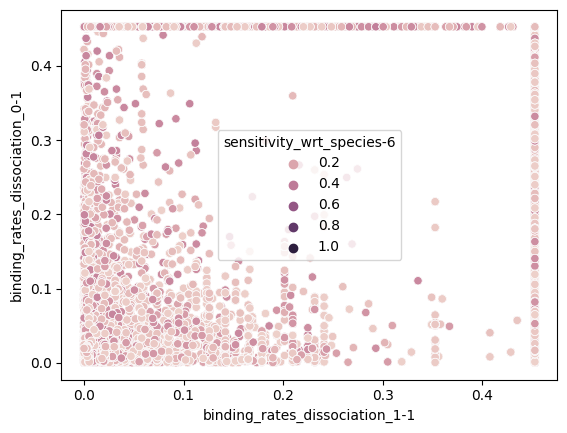

In [ ]:
sns.scatterplot(info, x='binding_rates_dissociation_1-1', y='binding_rates_dissociation_0-1', hue='sensitivity_wrt_species-6')

In [ ]:
sns.histplot(infom[infom['idx'] == 'energies_0-0'], x='sensitivity_wrt_species-6' + '_std', hue='mutation_num', element='step')

ValueError: Could not interpret value `sensitivity_wrt_species-6_std` for parameter `x`